In [2]:
import pandas as pd
import numpy as np
import sys
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
sys.path.append('../')

from cool_train.data_loading import correct_column_types

# df = pd.read_csv('../dataset/data_cleaned.csv', index_col=[0])
df = pd.read_csv('../dataset/train_181/train_181.csv',sep=';')

df = correct_column_types(df)
df


,id,vehicle_id,timestamps_UTC,Insert_Datetime,lat,lon,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,...,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2,Sensors_NB_Fail,OutOfRange_NB,IsInvalidLine,IsTreated,ID_Org,mapped_veh_id_Org
0,3,181,2023-08-25 08:40:11,2023-11-06 14:48:39.443,51.167318,4.768149,45.0,39.0,420.0,341.0,...,88.0,88.0,84.0,87.0,0,0,0,0,17377,181.0
1,4,181,2023-08-25 08:52:14,2023-11-06 14:48:39.443,51.188465,4.846686,43.0,32.0,203.0,200.0,...,84.0,88.0,81.0,87.0,0,0,0,0,17378,181.0
2,150,181,2023-08-02 14:05:52,2023-11-06 14:48:39.443,51.034942,3.711887,42.0,33.0,396.0,338.0,...,83.0,87.0,77.0,85.0,0,0,0,0,17524,181.0
3,185,181,2023-08-02 02:08:11,2023-11-06 14:48:39.443,50.769412,3.871828,20.0,18.0,510.0,489.0,...,42.0,46.0,25.0,30.0,0,0,0,0,17559,181.0
4,190,181,2023-08-02 02:57:49,2023-11-06 14:48:39.443,50.769818,3.872029,26.0,22.0,317.0,289.0,...,72.0,71.0,61.0,62.0,0,0,0,0,17564,181.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
265489,10913760,181,2023-03-02 19:14:43,2023-11-06 14:48:39.443,51.035736,3.711618,28.0,9.0,244.0,217.0,...,81.0,82.0,77.0,84.0,0,0,0,0,10888522,181.0
265490,10913793,181,2023-03-02 21:25:34,2023-11-06 14:48:39.443,50.860273,3.613172,36.0,21.0,224.0,203.0,...,83.0,90.0,84.0,92.0,0,0,0,0,10888555,181.0
265491,10913858,181,2023-03-03 02:32:22,2023-11-06 14:48:39.443,50.855451,3.606423,14.0,5.0,276.0,267.0,...,76.0,71.0,66.0,NaN,0,0,0,0,10888620,181.0
265492,10913882,181,2023-03-03 03:27:23,2023-11-06 14:48:39.443,50.851097,3.601409,11.0,6.0,282.0,262.0,...,72.0,70.0,69.0,69.0,0,0,0,0,10888644,181.0


In [4]:
selected_cols = ['RS_E_InAirTemp_PC1', 'RS_E_InAirTemp_PC2',
                 'RS_E_OilPress_PC1','RS_E_OilPress_PC2',
                 'RS_E_RPM_PC1','RS_E_RPM_PC2',
                 'RS_E_WatTemp_PC1','RS_E_WatTemp_PC2',
                 'RS_T_OilTemp_PC1','RS_T_OilTemp_PC2']

correlation_matrix  = df[selected_cols].corr()
correlation_matrix

,RS_E_InAirTemp_PC1,RS_E_InAirTemp_PC2,RS_E_OilPress_PC1,RS_E_OilPress_PC2,RS_E_RPM_PC1,RS_E_RPM_PC2,RS_E_WatTemp_PC1,RS_E_WatTemp_PC2,RS_T_OilTemp_PC1,RS_T_OilTemp_PC2
RS_E_InAirTemp_PC1,1.000000,0.833444,-0.179359,-0.237342,0.200754,0.255168,0.538324,0.624807,0.568197,0.647298
RS_E_InAirTemp_PC2,0.833444,1.000000,-0.136683,-0.279249,0.164013,0.130921,0.388266,0.506702,0.443689,0.489343
RS_E_OilPress_PC1,-0.179359,-0.136683,1.000000,0.823699,0.798397,0.676127,0.060405,-0.100746,-0.043750,-0.154605
RS_E_OilPress_PC2,-0.237342,-0.279249,0.823699,1.000000,0.595764,0.690373,-0.129836,-0.204269,-0.259998,-0.273777
RS_E_RPM_PC1,0.200754,0.164013,0.798397,0.595764,1.000000,0.902009,0.419692,0.311392,0.404867,0.318653
RS_E_RPM_PC2,0.255168,0.130921,0.676127,0.690373,0.902009,1.000000,0.345910,0.351770,0.321767,0.362592
RS_E_WatTemp_PC1,0.538324,0.388266,0.060405,-0.129836,0.419692,0.345910,1.000000,0.807229,0.851532,0.733463
RS_E_WatTemp_PC2,0.624807,0.506702,-0.100746,-0.204269,0.311392,0.351770,0.807229,1.000000,0.748577,0.872203
RS_T_OilTemp_PC1,0.568197,0.443689,-0.043750,-0.259998,0.404867,0.321767,0.851532,0.748577,1.000000,0.864988
RS_T_OilTemp_PC2,0.647298,0.489343,-0.154605,-0.273777,0.318653,0.362592,0.733463,0.872203,0.864988,1.000000


In [5]:
# Get the top 10 correlated variable pairs
top_correlations = correlation_matrix.unstack().sort_values(ascending=False).drop_duplicates()[1:20]

# Display the result
print("Top 10 correlated variable pairs:")
print(top_correlations)

Top 10 correlated variable pairs:
RS_E_RPM_PC2        RS_E_RPM_PC1          0.902009
RS_T_OilTemp_PC2    RS_E_WatTemp_PC2      0.872203
                    RS_T_OilTemp_PC1      0.864988
RS_E_WatTemp_PC1    RS_T_OilTemp_PC1      0.851532
RS_E_InAirTemp_PC2  RS_E_InAirTemp_PC1    0.833444
RS_E_OilPress_PC1   RS_E_OilPress_PC2     0.823699
RS_E_WatTemp_PC2    RS_E_WatTemp_PC1      0.807229
RS_E_OilPress_PC1   RS_E_RPM_PC1          0.798397
RS_T_OilTemp_PC1    RS_E_WatTemp_PC2      0.748577
RS_E_WatTemp_PC1    RS_T_OilTemp_PC2      0.733463
RS_E_RPM_PC2        RS_E_OilPress_PC2     0.690373
RS_E_OilPress_PC1   RS_E_RPM_PC2          0.676127
RS_T_OilTemp_PC2    RS_E_InAirTemp_PC1    0.647298
RS_E_WatTemp_PC2    RS_E_InAirTemp_PC1    0.624807
RS_E_OilPress_PC2   RS_E_RPM_PC1          0.595764
RS_E_InAirTemp_PC1  RS_T_OilTemp_PC1      0.568197
                    RS_E_WatTemp_PC1      0.538324
RS_E_WatTemp_PC2    RS_E_InAirTemp_PC2    0.506702
RS_E_InAirTemp_PC2  RS_T_OilTemp_PC2      0.4893

In [6]:

# Create a pair plot
sns.set(style="ticks")
sns.pairplot(df[selected_cols], height=3, aspect=1)
plt.show()

KeyboardInterrupt: 

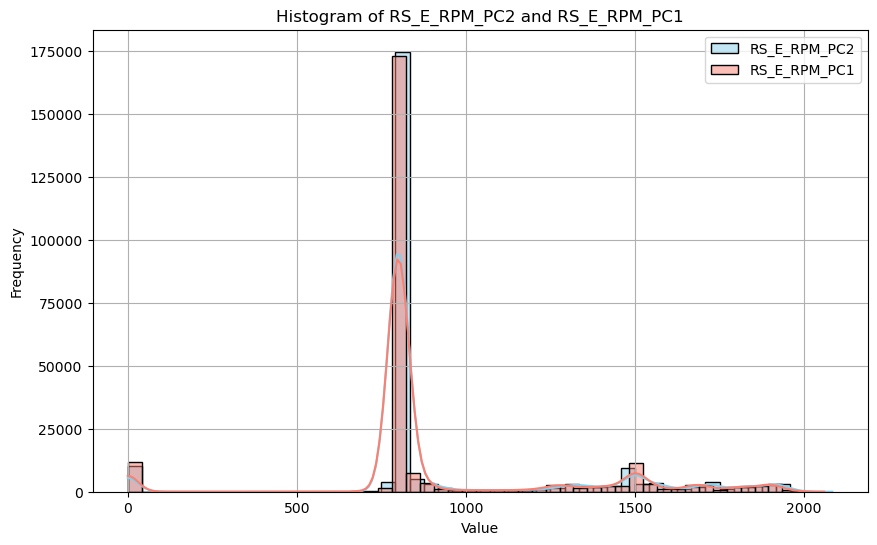

In [62]:
# Create a beautiful histogram for RS_E_RPM_PC2 and RS_E_RPM_PC1
plt.figure(figsize=(10, 6))
sns.histplot(data=df, x='RS_E_RPM_PC2', bins=50, kde=True, color='skyblue', label='RS_E_RPM_PC2')
sns.histplot(data=df, x='RS_E_RPM_PC1', bins=50, kde=True, color='salmon', label='RS_E_RPM_PC1')

plt.title('Histogram of RS_E_RPM_PC2 and RS_E_RPM_PC1')
plt.xlabel('Value')
plt.ylabel('Frequency')
plt.grid(True)
plt.legend()
plt.show()

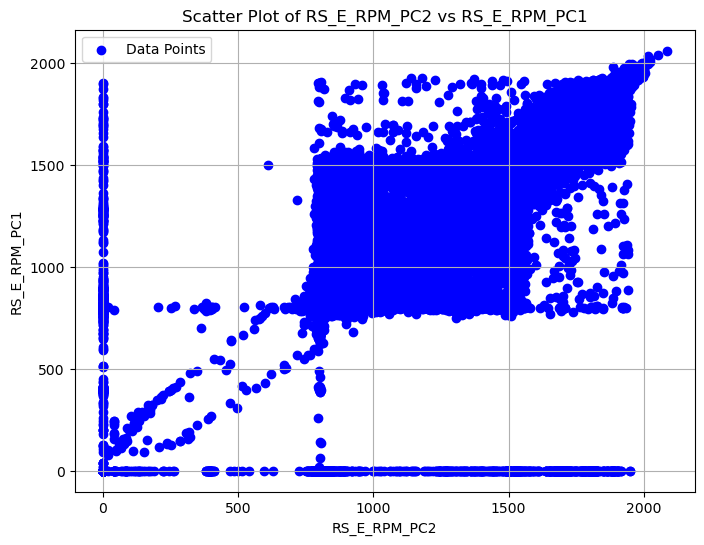

In [8]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

col1 = 'RS_E_RPM_PC2'
col2 = 'RS_E_RPM_PC1'

# Scatter plot
plt.figure(figsize=(8, 6))  # Adjust the figure size as needed

plt.scatter(df[col1], df[col2], color='blue', marker='o', label='Data Points')

plt.title(f'Scatter Plot of {col1} vs {col2}')
plt.xlabel(col1)
plt.ylabel(col2)
plt.legend()  # Display legend if you have multiple datasets

plt.grid(True)
plt.show()


# Kernel Density Plot
This takes quite some time

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

# Scatter plot
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed

# Scatter plot
plt.subplot(1, 2, 1)
plt.scatter(df[col1], df[col2], color='blue', marker='o', label='Data Points')
plt.title(f'Scatter Plot of {col1} vs {col2}')
plt.xlabel(col1)
plt.ylabel(col2)
plt.grid(True)
plt.legend()

# 2D Kernel Density Estimation
plt.subplot(1, 2, 2)
sns.kdeplot(x=df[col1], y=df[col2], cmap='viridis', fill=True)
plt.title('2D Kernel Density Estimation')
plt.xlabel(col1)
plt.ylabel(col2)

plt.grid(True)
plt.tight_layout()  # Adjust layout for better presentation
plt.show()


# Plotly

In [9]:
import plotly.express as px
import pandas as pd

# Scatter plot using Plotly Express
fig = px.scatter(df, x=col1, y=col2, hover_data=[col1, col2, 'timestamps_UTC'],
                 labels={'timestamps_local': 'Timestamp '},
                 title=f'Scatter Plot of {col1} vs {col2}')

fig.update_layout(width=800, height=800)  # Adjust figure size
fig.show()

## Basic Clutering of RPM phases
- From the scatter plot of RMP1 vs RMP2, I saw different patterns:
  - Highest correlation
  - Vitesse nominale: 800 RPM (voir 2 histograms)
  - Bcp de valeurs proches de 0 pour l'un ou l'autre
  - Phases de demarrage (transition) ou RPMs <650
  - Phase de marche ou RPMs > 650
  - 2 points inhabituels
  - A tester : le meme graphe pour un autre train


- The goal of this subpart is to plot the different phases on the time series 
- We expect:
    - phase_demarrage to be in the start of a run
    - phase_marche to be in the middle of a run
    - phase_zero to be ?

In [49]:
th_marche = 750

# Define clustering conditions
condition2 = (df[col2] >= th_marche) & (df[col1] >= th_marche)
condition1 = (df[col2] < th_marche) & (df[col1] < th_marche)
condition3 = (df[col2] == 0) | (df[col1] == 0)


# Create a new column 'cluster' based on conditions
df['cluster'] = 'Other'
df.loc[condition3, 'cluster'] = 'phase_zero'
df.loc[condition1, 'cluster'] = 'phase_demarrage'
df.loc[condition2, 'cluster'] = 'phase_marche'


In [63]:
df['cluster'].value_counts()

phase_marche       228465
Other               22449
phase_demarrage      7965
phase_zero           6615
Name: cluster, dtype: int64

Show it in a scatter plot

c:\Users\mouli\anaconda3\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Creating legend with loc="best" can be slow with large amounts of data.



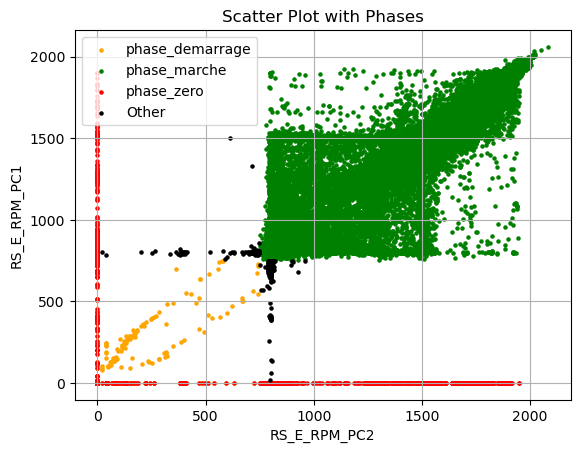

In [50]:
# Show the scatter plot with colored clusters
plt.scatter(df.loc[condition1, 'RS_E_RPM_PC2'], df.loc[condition1, 'RS_E_RPM_PC1'], color='orange', marker='o', label='phase_demarrage', s=5)
plt.scatter(df.loc[condition2, 'RS_E_RPM_PC2'], df.loc[condition2, 'RS_E_RPM_PC1'], color='green', marker='o', label='phase_marche', s=5)
plt.scatter(df.loc[condition3, 'RS_E_RPM_PC2'], df.loc[condition3, 'RS_E_RPM_PC1'], color='red', marker='o', label='phase_zero', s=5)
plt.scatter(df[df['cluster']=='Other']['RS_E_RPM_PC2'], df[df['cluster']=='Other']['RS_E_RPM_PC1'], color='black', marker='o', label='Other', s=5)



plt.title('Scatter Plot with Phases')
plt.xlabel(col1)
plt.ylabel(col2)
plt.legend()
plt.grid(True)
plt.show()

## Show the timeseries

In [51]:
df = df.sort_values(by='timestamps_UTC')

In [52]:
import plotly.graph_objects as go
import datetime

# Variable to plot
var = 'RS_E_RPM_PC2'

# Filter the DataFrame for the first two months
start_date = datetime.datetime(2023,2,1)
end_date = datetime.datetime(2023,3,15)

# Filter rows between the specified dates
df_to_plot = df[df['timestamps_UTC'].between(start_date, end_date)]

# Create a time series plot with color-coded points based on the 'cluster' column
fig = go.Figure()

for cluster, color in zip(['phase_demarrage', 'Other', 'phase_marche', 'phase_zero'], ['orange', 'black','green','red']):
    cluster_data = df_to_plot[df_to_plot['cluster'] == cluster]
    fig.add_trace(go.Scatter(x=cluster_data['timestamps_UTC'], y=cluster_data[var],
                             mode='markers', marker=dict(color=color), name=cluster))

fig.update_layout(title='Time Series Plot with Cluster Colors (Subset)',
                  xaxis_title='Date', yaxis_title=var)

fig.show()

## KDE of cluster vs Hour of the Day
- Is the phase related to the hour of the day? We expect the transition phases to be in the morning or the evening, and the runtime/normal phase to be during the full day

In [53]:
df['hour_day'] = df['timestamps_UTC'].apply(lambda x:x.hour)

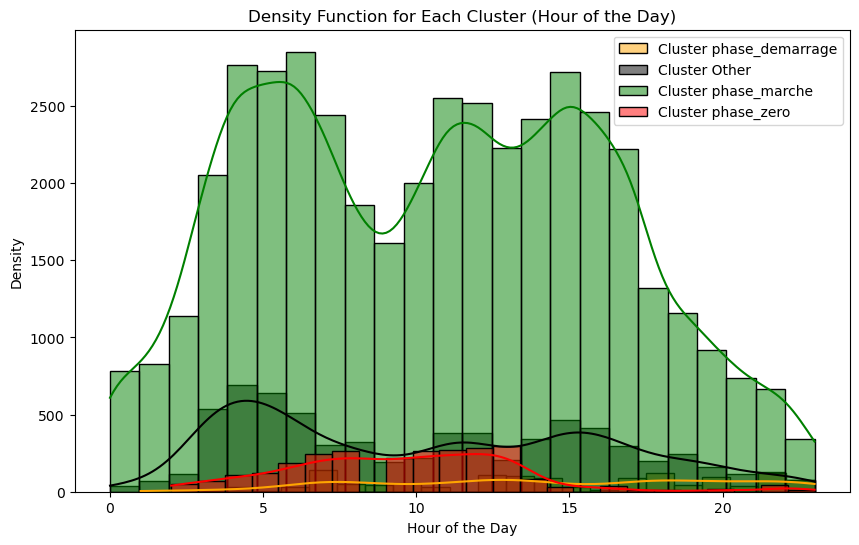

In [56]:
# Variable to plot
var = 'RS_E_RPM_PC2'

# Filter the DataFrame for the first two months
start_date = datetime.datetime(2023,2,1)
end_date = datetime.datetime(2023,3,15)

# Filter rows between the specified dates
df_to_plot = df[df['timestamps_UTC'].between(start_date, end_date)]

# Create density plots for each cluster
plt.figure(figsize=(10, 6))
for cluster, color in zip(['phase_demarrage', 'Other', 'phase_marche', 'phase_zero'], ['orange', 'black','green','red']):
    cluster_data = df_to_plot[df_to_plot['cluster'] == cluster]
    #sns.kdeplot(data=cluster_data, x='hour_day', label=f'Cluster {cluster}', color=color, fill=True)
    sns.histplot(data=cluster_data, x='hour_day', bins=24, kde=True, stat='count', label=f'Cluster {cluster}', color=color)

plt.title('Density Function for Each Cluster (Hour of the Day)')
plt.xlabel('Hour of the Day')
plt.ylabel('Density')
plt.legend()
plt.show()

-> No clear link with the hour of the day